# Clustering of all gastruloid data

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pandas import read_csv
import scanpy as sc
from functools import reduce
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
from anndata import AnnData, read_h5ad
import singlecellmultiomics.bamProcessing.bamToRNACounts

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()

/var/folders/pb/hvc2shb53x194_v0c3h_jyccsf3dhb/T/ipykernel_4291/2452997345.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
sc.settings.set_figure_params(dpi=300)



# Load the dataset

In [5]:
pathToData = '/Users/m.blotenburg/Documents/Projects/Lianne/data/'

In [6]:
df = pd.read_pickle(pathToData + 'dataframes/20220217_all_mESCs.pickle.gz')

In [7]:
results_file = pathToData + '/dataframes/20230124_adata_dataset_ESC_all.h5ad'  # the file that will store the analysis results

In [8]:
df.head()

,1_1.l-ESC_con1,1_10.l-ESC_con1,1_100.l-ESC_con1,1_101.l-ESC_con1,1_102.l-ESC_con1,1_103.l-ESC_con1,1_104.l-ESC_con1,1_105.l-ESC_con1,1_106.l-ESC_con1,1_107.l-ESC_con1,...,e12_90.m-ESC_con6,e12_91.m-ESC_con6,e12_92.m-ESC_con6,e12_93.m-ESC_con6,e12_94.m-ESC_con6,e12_95.m-ESC_con6,e12_96.m-ESC_con6,e12_97.m-ESC_con6,e12_98.m-ESC_con6,e12_99.m-ESC_con6
ENSMUSG00000104017_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ENSMUSG00000033845_1,13.0,10.0,12.0,14.0,15.0,10.0,3.0,5.0,NaN,NaN,...,5.0,NaN,3.0,2.0,NaN,2.0,1.0,1.0,NaN,4.0
ENSMUSG00000025903_1,10.0,4.0,10.0,15.0,4.0,1.0,NaN,1.0,NaN,NaN,...,4.0,NaN,1.0,3.0,NaN,1.0,2.0,NaN,NaN,2.0
ENSMUSG00000033813_1,14.0,3.0,10.0,12.0,14.0,8.0,1.0,2.0,2.0,NaN,...,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
ENSMUSG00000033793_1,2.0,3.0,6.0,10.0,5.0,1.0,NaN,NaN,NaN,NaN,...,8.0,NaN,1.0,2.0,NaN,1.0,2.0,NaN,NaN,5.0


In [9]:
df = df.fillna(0)

In [10]:
print(df.shape)

(33152, 9204)


In [11]:
df = df.loc[df.index.dropna()]

In [12]:
df = df.astype(float)

select data

In [13]:
df_m = df.iloc[:,['m-ESC' in x for x in df.columns]]

In [14]:
adata = sc.AnnData(df_m.transpose())

/var/folders/pb/hvc2shb53x194_v0c3h_jyccsf3dhb/T/ipykernel_8877/3693600300.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = sc.AnnData(df_m.transpose())


# Preprocessing of dataset 1 - 120h AA

make gene names more workable

In [15]:
adata.var.index = adata.var.index.str.split('_',0,expand=True)

In [17]:
index = adata.var.reset_index(level=(1))
index = index.rename(index=str, columns={"level_1": "chromosome"})
index.head()

,chromosome
ENSMUSG00000104017,1
ENSMUSG00000033845,1
ENSMUSG00000025903,1
ENSMUSG00000033813,1
ENSMUSG00000033793,1


In [19]:
index['ensembl'] = index.index

In [20]:
adata.var.index = index.index

In [21]:
adata.var['ensembl'] = index['ensembl']
adata.var['chromosome'] = index['chromosome']

In [23]:
conversion_table = singlecellmultiomics.bamProcessing.bamToRNACounts.get_gene_id_to_gene_name_conversion_table('/Users/m.blotenburg/Documents/Projects/TCHIC/data/jupyter_notebooks/QC/standard_files/exons.gtf.gz')

In [24]:
adata.var_names = np.array([conversion_table.get(x,x) for x in adata.var_names ])

In [25]:
adata.var_names_make_unique()

In [26]:
adata.var.head()

,ensembl,chromosome
Gm37363,ENSMUSG00000104017,1
Mrpl15,ENSMUSG00000033845,1
Lypla1,ENSMUSG00000025903,1
Tcea1,ENSMUSG00000033813,1
Atp6v1h,ENSMUSG00000033793,1


Show those genes that yield the highest fraction of counts in each single cells, across all cells.

normalizing counts per cell
    finished (0:00:00)


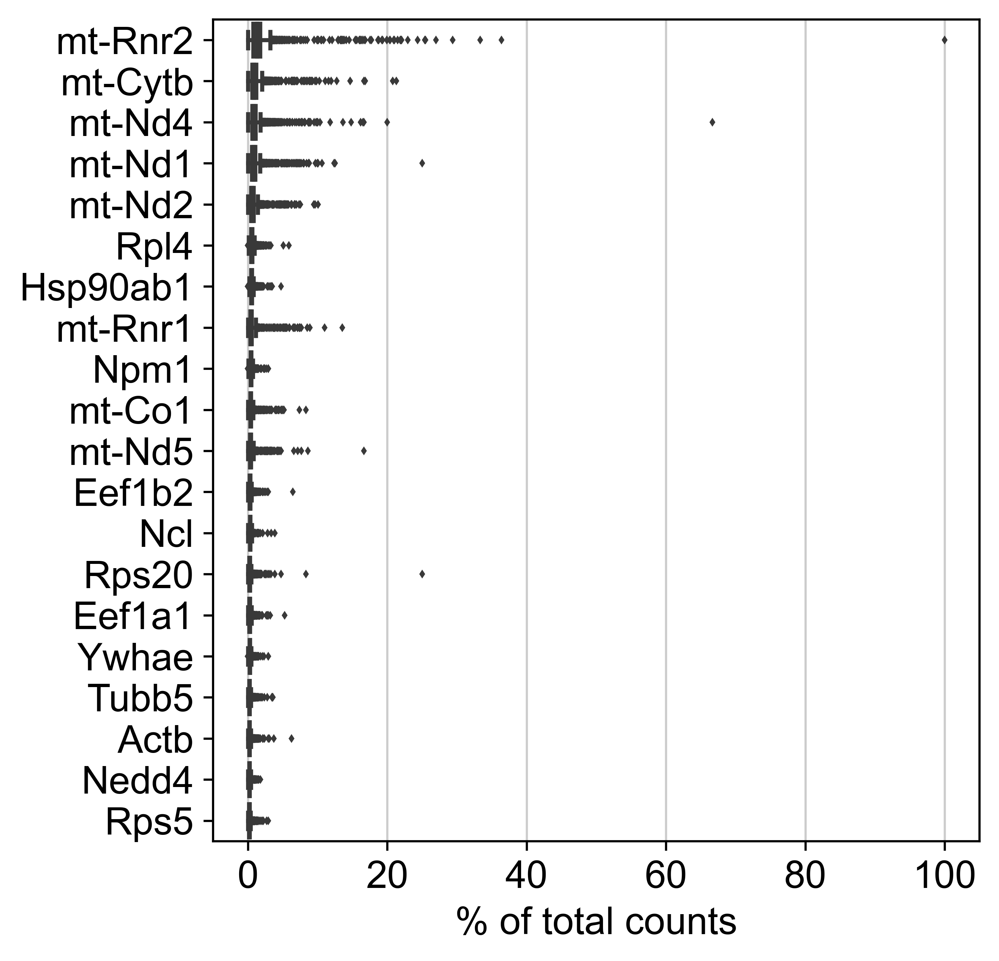

In [27]:
sc.pl.highest_expr_genes(adata, n_top=20)

Basic filtering.

In [28]:
adata

AnnData object with n_obs × n_vars = 4605 × 33152
    var: 'ensembl', 'chromosome'

In [29]:
adata.write(results_file)

# To load adata file with corrected gene names and continue:

In [30]:
#adata = sc.read(results_file)

In [31]:
adata

AnnData object with n_obs × n_vars = 4605 × 33152
    var: 'ensembl', 'chromosome'

In [32]:
adata.var

,ensembl,chromosome
Gm37363,ENSMUSG00000104017,1
Mrpl15,ENSMUSG00000033845,1
Lypla1,ENSMUSG00000025903,1
Tcea1,ENSMUSG00000033813,1
Atp6v1h,ENSMUSG00000033793,1
...,...,...
Gm16372,ENSMUSG00000057160,12
AC108826.1,ENSMUSG00000116745,16
Gm22551,ENSMUSG00000088420,8
Mir6965,ENSMUSG00000099123,17


In [33]:
minCount = 500
sc.pp.filter_cells(adata, min_counts=minCount)
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=2)

filtered out 427 cells that have less than 500 counts
filtered out 8690 genes that are detected in less than 2 cells


Let us assemple some information about mitochondrial genes, which are important for quality control.

Citing from "Simple Single Cell" workflows [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics):

> High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

Note you can also use the function `pp.calculate_qc_metrics` to compute the fraction of mitochondrial genes and additional measures.

In [35]:
mito_genes = adata.var_names.str.startswith('mt-')

# for each cell compute fraction of counts in mito genes vs. all genes
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1) / np.sum(adata.X, axis=1)
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1)

A violin plot of the computed quality measures.

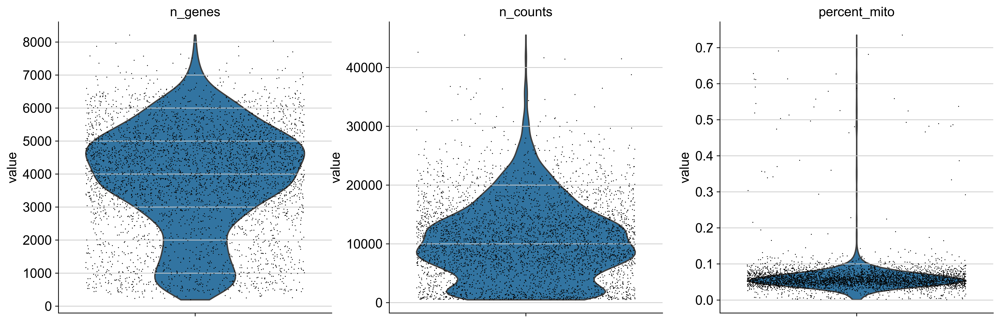

In [36]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

Remove cells that have too many mitochondrial genes expressed or too many total counts.

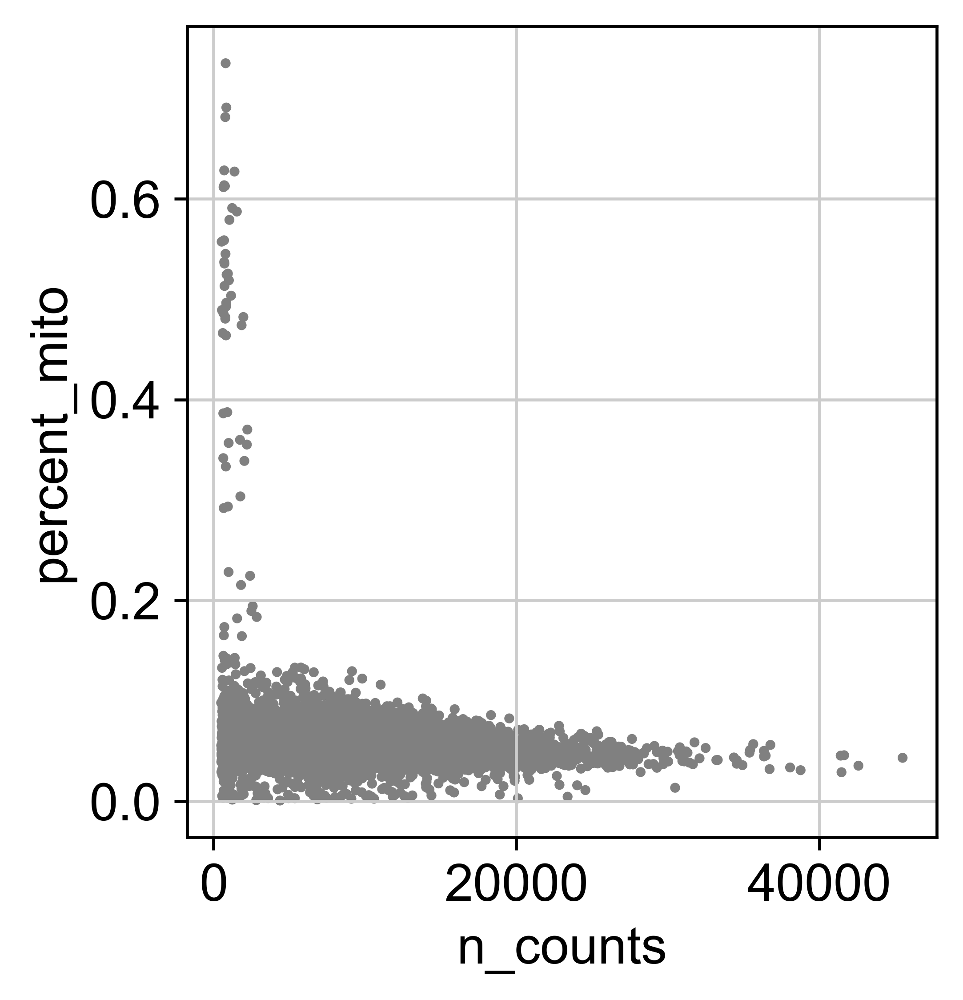

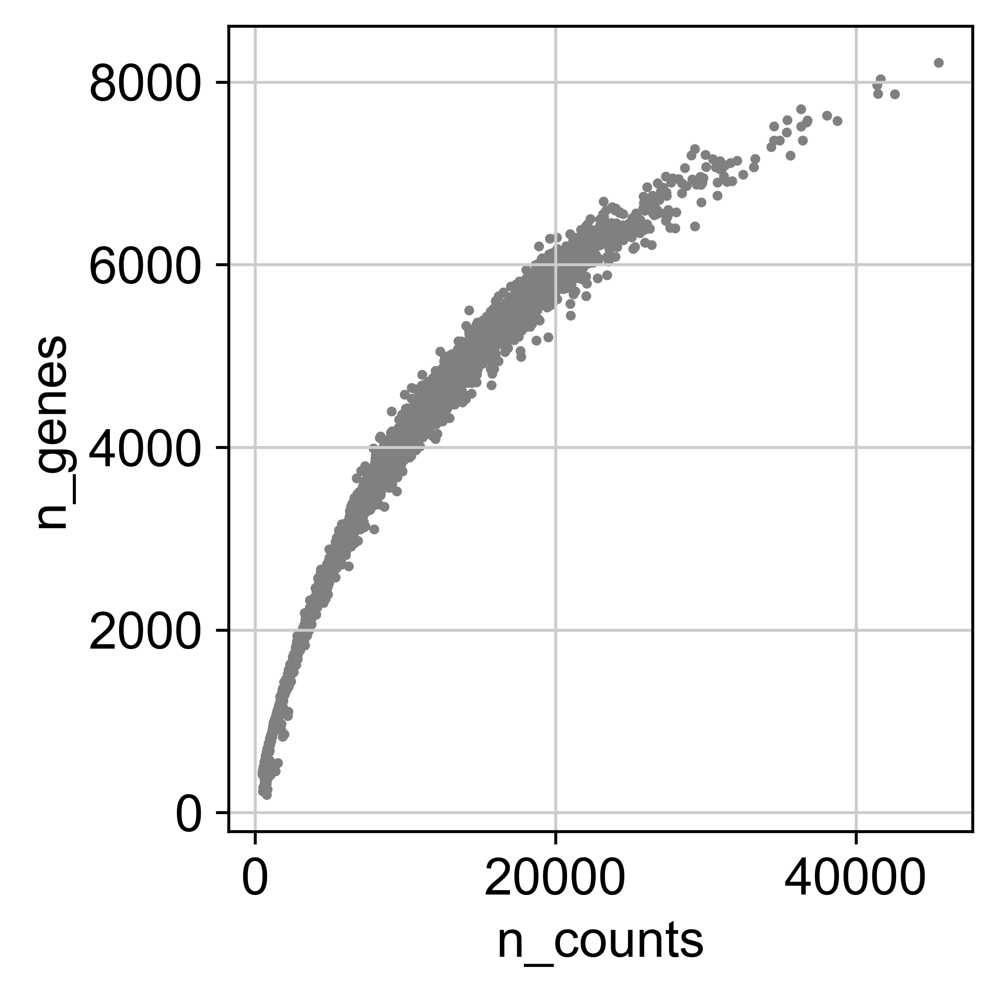

In [37]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [38]:
adata

AnnData object with n_obs × n_vars = 4178 × 24462
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells'

Actually do the filtering.

In [39]:
adata = adata[adata.obs['percent_mito'] < 0.4, :]

throw out any other unwanted genes

In [40]:
# removing genes with annotations we are not interested in
banned = ['NA', 'mt-', "Malat1", "Rpl",'Rps']
keptGenes = [geneName for geneName in adata.var.index if not any( (b in geneName for b in banned) )]

adata = adata[:,keptGenes]

adata

View of AnnData object with n_obs × n_vars = 4147 × 24136
    obs: 'n_counts', 'n_genes', 'percent_mito'
    var: 'ensembl', 'chromosome', 'n_cells'

minCount = 1000
sc.pp.filter_cells(adata, min_counts=minCount)
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=2)

Total-count normalize (library-size correct) the data matrix $\mathbf{X}$ to 10,000 reads per cell, so that counts become comparable among cells.

In [41]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=minCount)

normalizing by total count per cell


/Users/m.blotenburg/miniconda3/envs/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:524: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_n_counts] = counts_per_cell


    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


Logarithmize the data.

In [42]:
sc.pp.log1p(adata)

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object. While many people consider the normalized data matrix as the "relevant data" for visualization and differential testing, some would prefer to store the unnormalized data.

In [43]:
adata.raw = adata

Identify highly-variable genes.

In [44]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


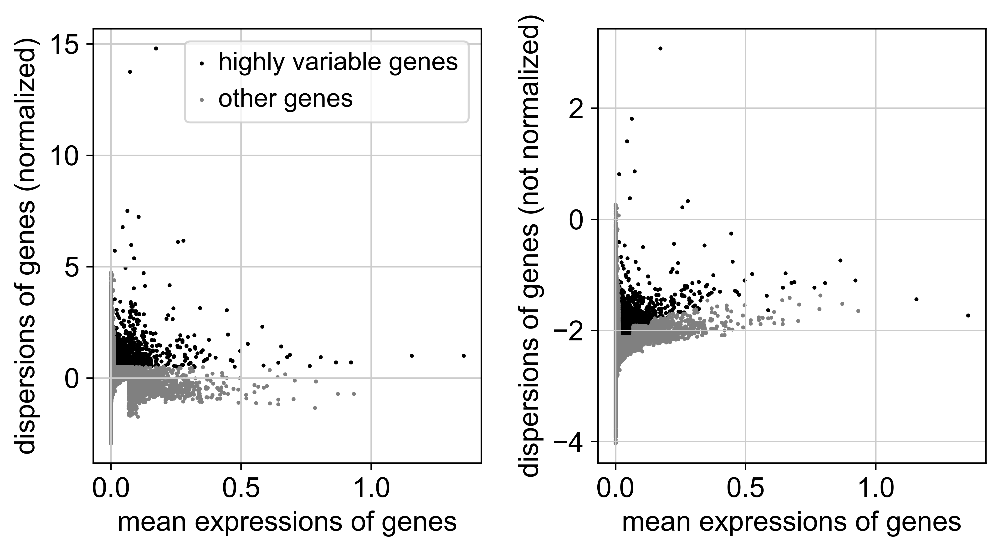

In [45]:
sc.pl.highly_variable_genes(adata)

Actually do the filtering.

In [46]:
#adata = adata[:, adata.var['highly_variable']]

regress out cell cycle effects

In [47]:
all_cc_genes = read_csv('./regev_lab_cell_cycle_genes_mouse.csv', index_col=False)

In [48]:
cell_cycle_genes = [x.strip() for x in open('./regev_lab_cell_cycle_genes.txt')]
s_genes_h = cell_cycle_genes[:43]
g2m_genes_h = cell_cycle_genes[43:]

In [49]:
s_genes = list(all_cc_genes[all_cc_genes['HGNC.symbol'].isin(s_genes_h)]['MGI.symbol'])
g2m_genes = list(all_cc_genes[all_cc_genes['HGNC.symbol'].isin(g2m_genes_h)]['MGI.symbol'])

all_cell_cycle_genes = [x for x in list(all_cc_genes['MGI.symbol']) if x in adata.var_names]

In [50]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    277 total control genes are used. (0:00:00)
computing score 'G2M_score'


/Users/m.blotenburg/miniconda3/envs/conda/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'G2M_score', score of gene set (adata.obs).
    238 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


/Users/m.blotenburg/miniconda3/envs/conda/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


computing PCA
    on highly variable genes
    with n_comps=35
    finished (0:00:00)


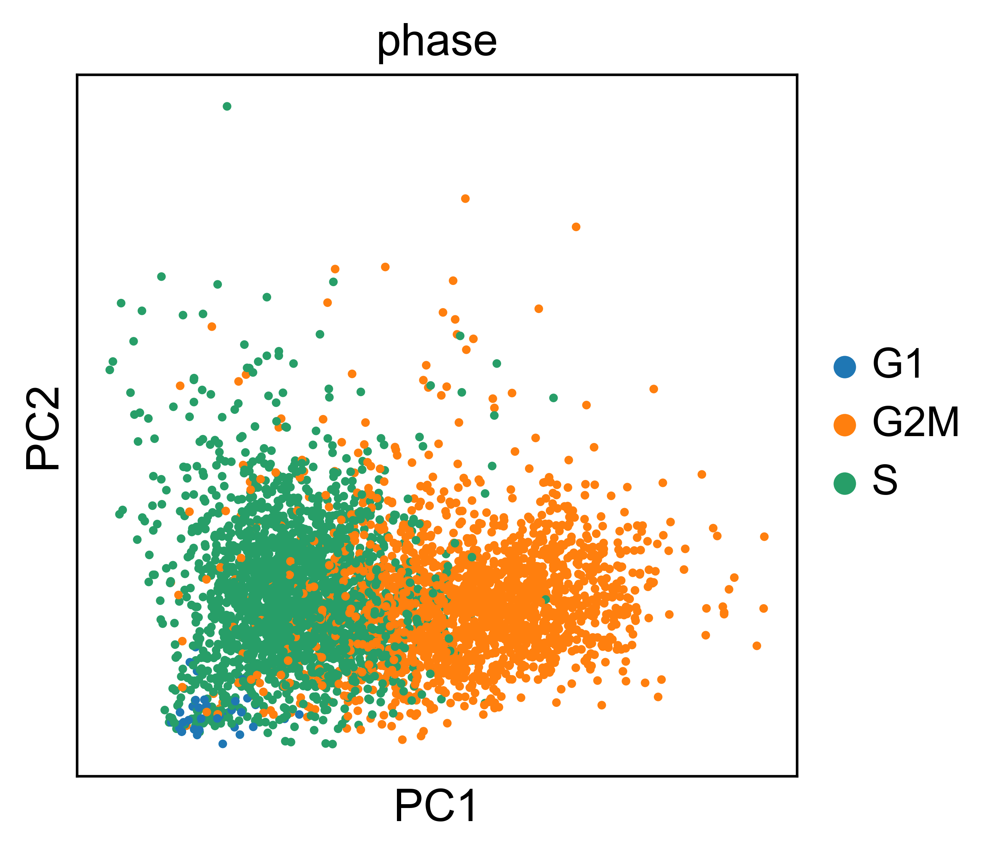

In [51]:
adata_cc_genes = adata[:, all_cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

Regress out effects of cell cycle, total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [52]:
sc.pp.regress_out(adata, ['S_score', 'G2M_score','n_counts', 'percent_mito'])
#sc.pp.scale(adata)

regressing out ['S_score', 'G2M_score', 'n_counts', 'percent_mito']
    finished (0:02:56)


computing PCA
    on highly variable genes
    with n_comps=35
    finished (0:00:00)


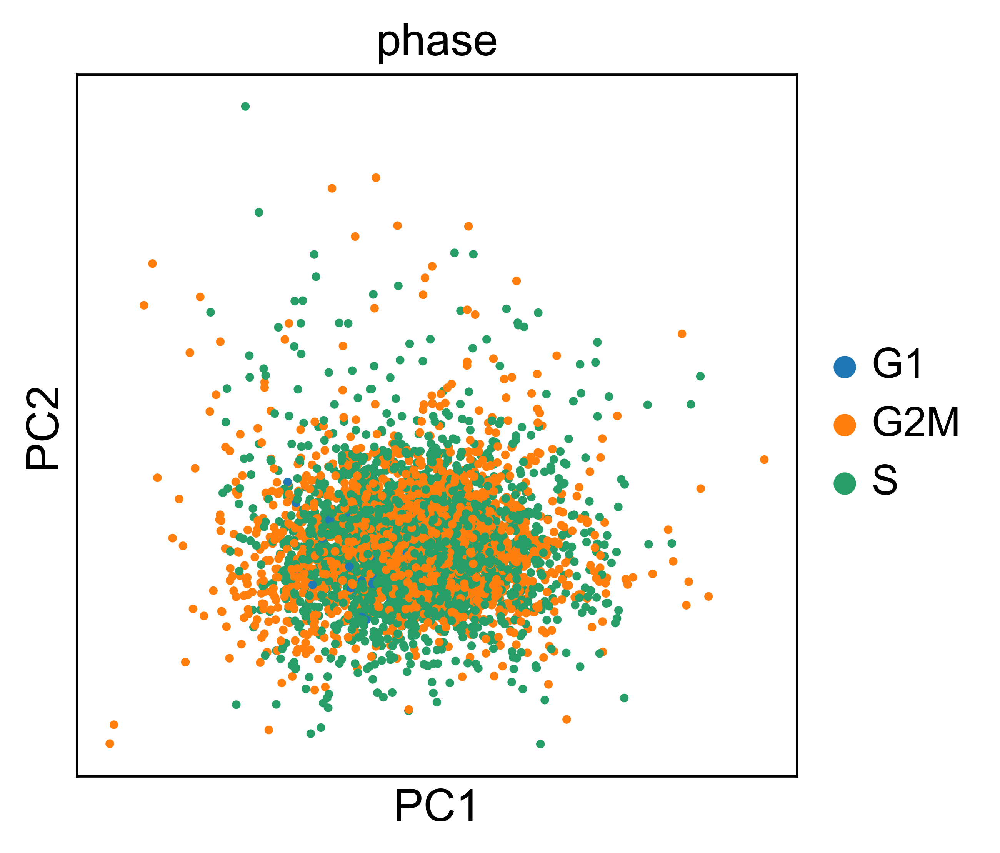

In [53]:
adata_cc_genes = adata[:, all_cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

In [54]:
#sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])

Scale each gene to unit variance. Clip values exceeding standard deviation 10. 

In [55]:
sc.pp.scale(adata, max_value=10)

In [56]:
adata.uns['log1p']

{'base': None}

In [58]:
adata

AnnData object with n_obs × n_vars = 4147 × 24136
    obs: 'n_counts', 'n_genes', 'percent_mito', 'S_score', 'G2M_score', 'phase'
    var: 'ensembl', 'chromosome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

In [59]:
batches = [ob.split('.')[1] for ob in adata.obs_names]
platenr = [ob.split('_')[0] for ob in adata.obs_names]
batch = [ob.split('_')[0] for ob in batches]
condition = [ob.split('_')[1] for ob in batches]

adata.obs['batch'] = batch
adata.obs['name'] = batches
adata.obs['condition'] = condition
adata.obs['plate'] = platenr

In [60]:
adata.obs.batch = batch

In [61]:
adata.obs

,n_counts,n_genes,percent_mito,S_score,G2M_score,phase,batch,name,condition,plate
e1_1.m-ESC_con1,7306.0,3604,0.068478,0.024311,0.121200,G2M,m-ESC,m-ESC_con1,con1,e1
e1_10.m-ESC_con1,9948.0,4020,0.032744,0.075215,0.022867,S,m-ESC,m-ESC_con1,con1,e1
e1_101.m-ESC_con1,12055.0,5011,0.052057,0.021817,0.110170,G2M,m-ESC,m-ESC_con1,con1,e1
e1_102.m-ESC_con1,8330.0,3877,0.091631,0.046089,0.106339,G2M,m-ESC,m-ESC_con1,con1,e1
e1_103.m-ESC_con1,3257.0,2232,0.094175,0.043077,0.060849,G2M,m-ESC,m-ESC_con1,con1,e1
...,...,...,...,...,...,...,...,...,...,...
e12_95.m-ESC_con6,6510.0,3359,0.055492,0.055952,0.037900,S,m-ESC,m-ESC_con6,con6,e12
e12_96.m-ESC_con6,8046.0,3834,0.005440,0.026168,0.120394,G2M,m-ESC,m-ESC_con6,con6,e12
e12_97.m-ESC_con6,2982.0,2000,0.070913,0.064887,0.045792,S,m-ESC,m-ESC_con6,con6,e12
e12_98.m-ESC_con6,6122.0,3231,0.008952,0.061465,0.009357,S,m-ESC,m-ESC_con6,con6,e12


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [62]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

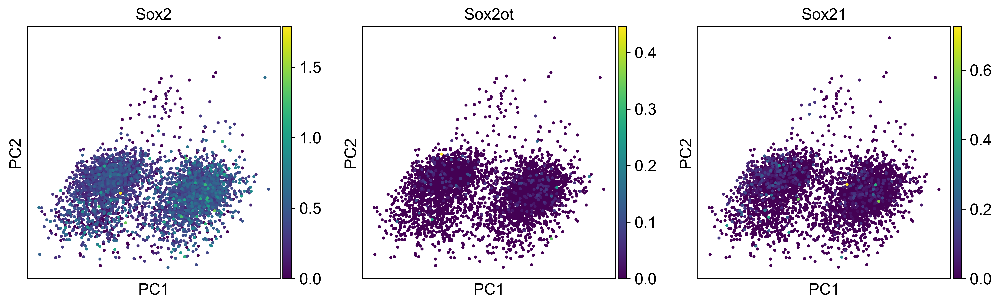

In [63]:
plotgene = [geneName for geneName in adata.var.index if any( (b in geneName for b in ['Sox2']) )]
sc.pl.pca(adata, color=plotgene)

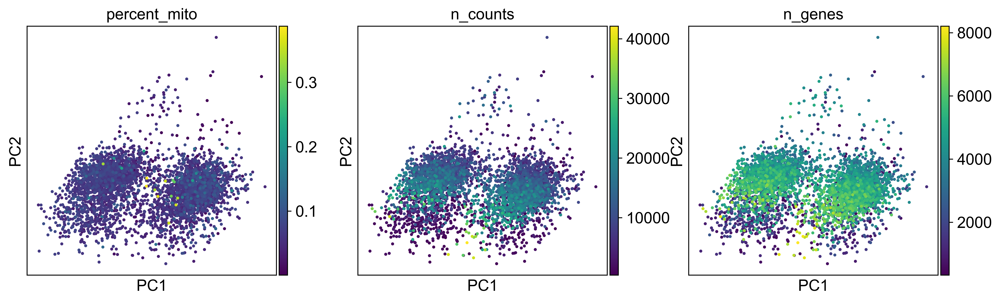

In [64]:
sc.pl.pca(adata, color=['percent_mito','n_counts','n_genes'])

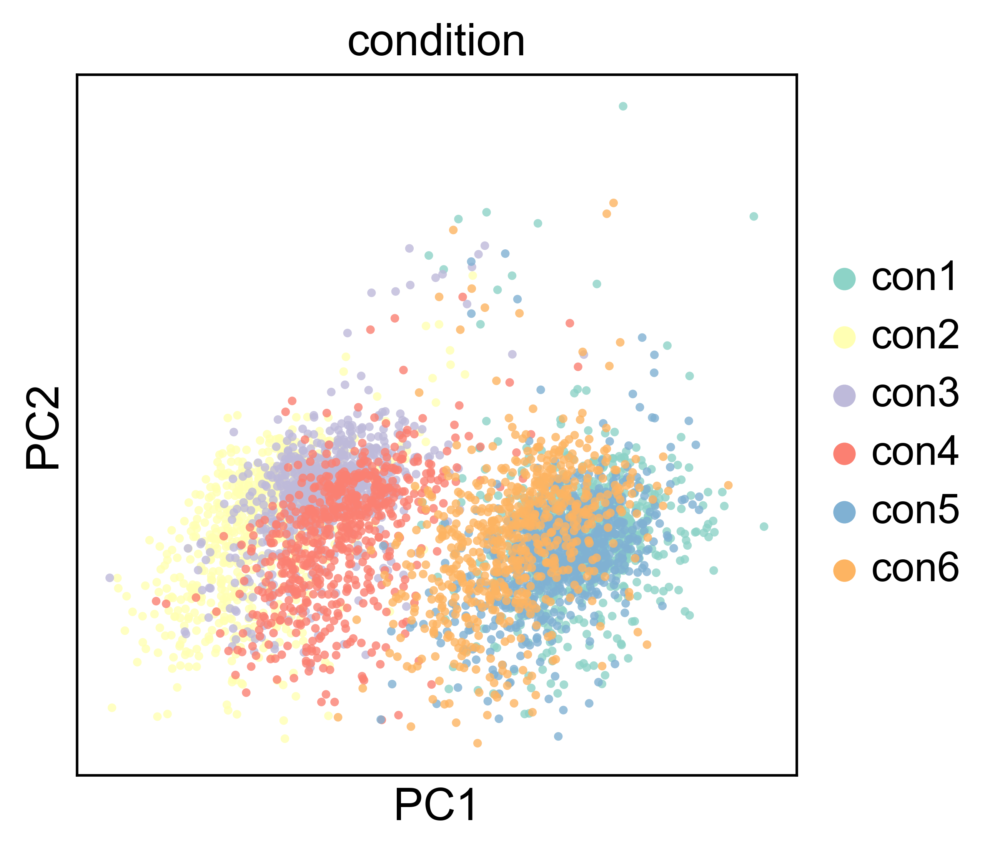

In [92]:
sc.pl.pca(adata, color=['condition'], alpha = 0.8, palette = sns.color_palette("Set3"), frameon=True)

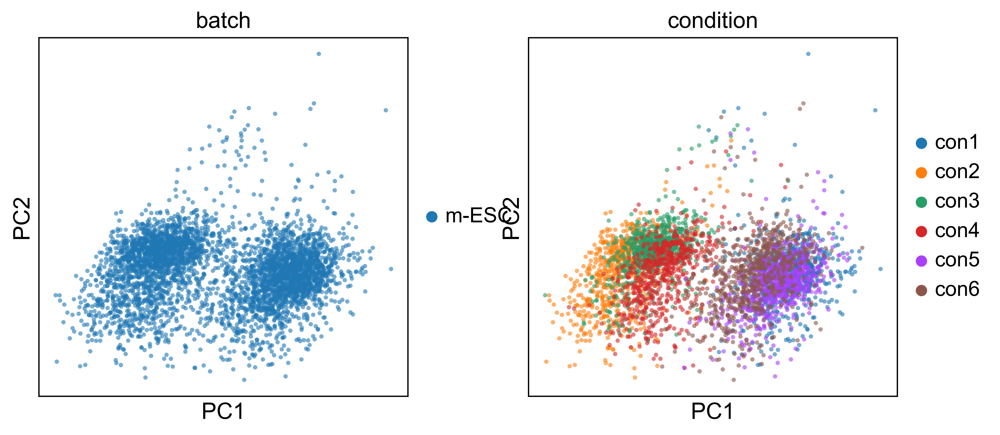

In [66]:
sc.pl.pca(adata, color=['batch', 'condition'], alpha = 0.6)

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [67]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=30)

computing neighbors
    using 'X_pca' with n_pcs = 30


/Users/m.blotenburg/miniconda3/envs/conda/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
OMP: Info #273: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)


In [68]:
adata.uns['log1p']

{'base': None}

## Embedding the neighborhood graph

We advertise embedding the graph in 2 dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is  potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preservers trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [69]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


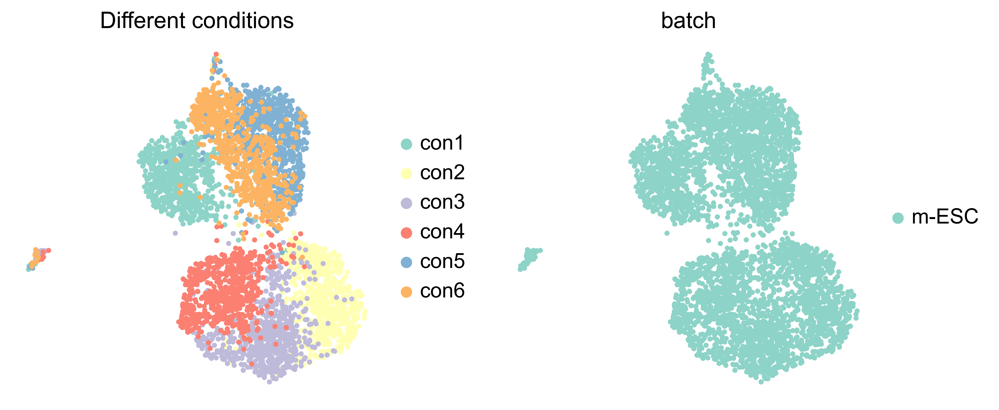

In [70]:
#fig, ax = plt.subplots(figsize=(5,5))
ax=sc.pl.umap(adata, color=['condition','batch'], #ax=ax, 
              palette=sns.color_palette("Set3"),size=40, frameon=False,
              title = 'Different conditions')

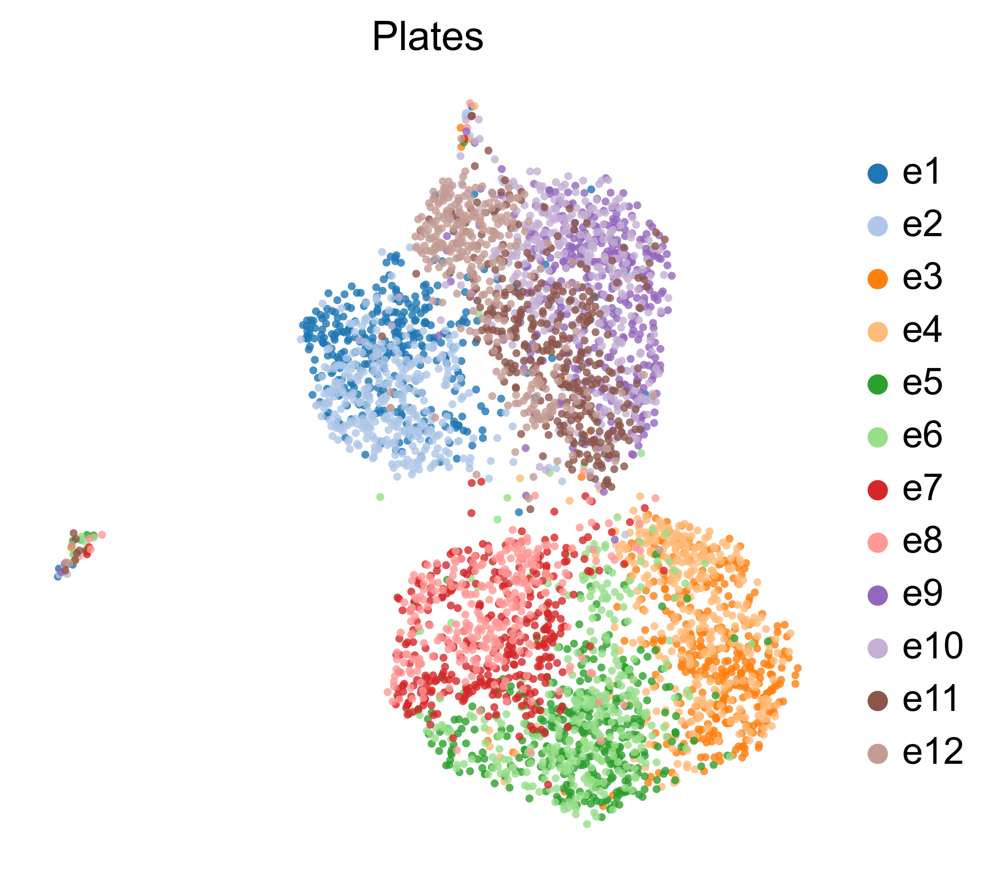

In [72]:
fig, ax = plt.subplots(figsize=(5,5))

ax=sc.pl.umap(adata, color='plate',ax=ax, palette=sns.color_palette("tab20", 24),size=30, frameon=False, alpha = 0.8,
             title = 'Plates')

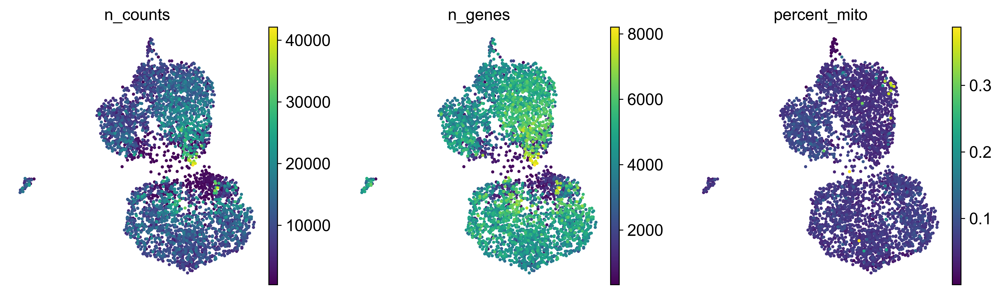

In [73]:
sc.pl.umap(adata, color=['n_counts', 'n_genes', 'percent_mito'], use_raw=True, frameon=False)

As we set the `.raw` attribute of `adata`, the previous plots showed the "raw" (normalized, logarithmized, but uncorrected) gene expression. You can also plot the scaled and corrected gene expression by explicitly stating that you don't want to use `.raw`.

In [74]:
#sc.pl.umap(adata, color=['Esrrb', 'Sox2', 'Dppa2', 'Nanog'], use_raw=True, size = 50, frameon = False)

## Clustering the neighborhood graph

As Seurat and many others, we recommend the Louvain graph-clustering method (community detection based on optimizing modularity). It has been proposed for single-cell data by [Levine et al. (2015)](https://doi.org/10.1016/j.cell.2015.05.047). Note that Louvain clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [75]:
sc.tl.leiden(adata, resolution=0.5)

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

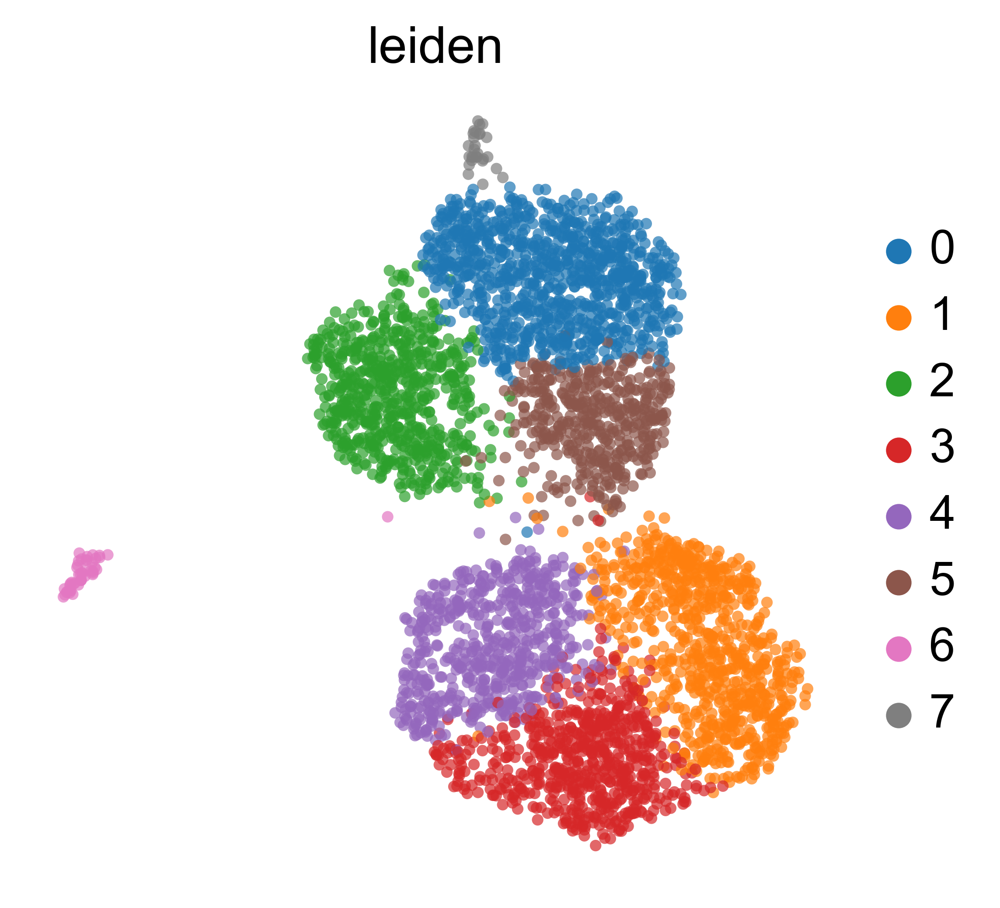

In [99]:
fig, ax = plt.subplots(figsize=(4,4))
sc.pl.umap(adata, color='leiden',ax=ax, palette=sns.color_palette("tab10"),size=40, frameon=False, alpha = 0.7)

## Finding marker genes

In [139]:
sc.settings.verbosity = 2  # reduce the verbosity

The result of a [Wilcoxon rank-sum (Mann-Whitney-U)](https://de.wikipedia.org/wiki/Wilcoxon-Mann-Whitney-Test) test is very similar. We recommend using the latter in publications, see e.g., [Sonison & Robinson (2018)](https://doi.org/10.1038/nmeth.4612). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

In [141]:
adata.uns['log1p'] = {'base':None}
adata.uns['log1p']

{'base': None}

ranking genes
    finished (0:00:18)


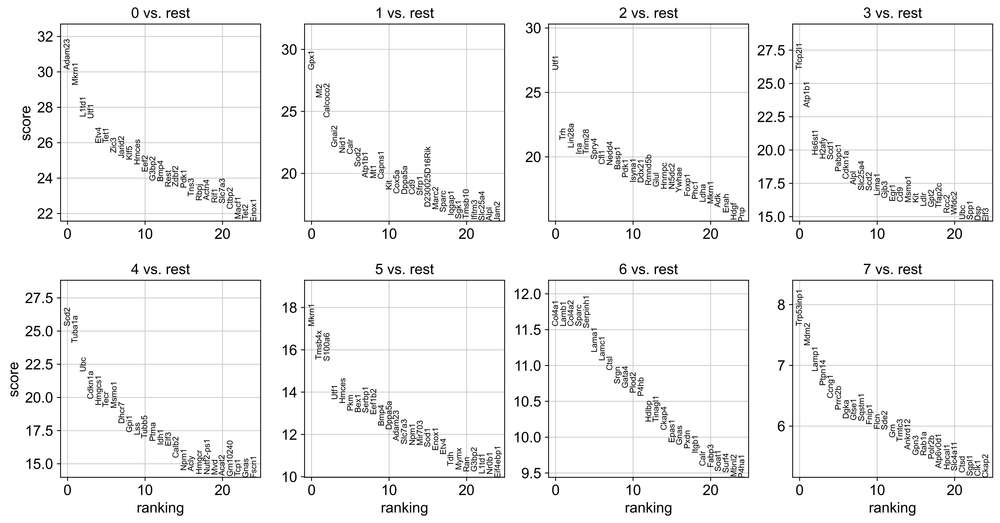

In [142]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Save the result.

In [143]:
adata.write(results_file)